# Ejercicio 2

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, MiniBatchKMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.pipeline import make_pipeline
import joblib

In [2]:
#Le indicamos el numero de nucleos del procesador va a usar
import os
os.environ["OMP_NUM_THREADS"] = "7"  # Ajusta el número de hilos según sea necesario


In [3]:
# Cargar el archivo CSV con los datos de las imágenes
data = pd.read_csv('../../../datos/olivetti_faces.csv')
X = data.values  
X

array([[0.30991736, 0.3677686 , 0.41735536, ..., 0.15289256, 0.16115703,
        0.1570248 ],
       [0.45454547, 0.47107437, 0.5123967 , ..., 0.15289256, 0.15289256,
        0.15289256],
       [0.3181818 , 0.40082645, 0.49173555, ..., 0.14049587, 0.14876033,
        0.15289256],
       ...,
       [0.5       , 0.53305787, 0.607438  , ..., 0.17768595, 0.14876033,
        0.19008264],
       [0.21487603, 0.21900827, 0.21900827, ..., 0.57438016, 0.59090906,
        0.60330576],
       [0.5165289 , 0.46280992, 0.28099173, ..., 0.35950413, 0.3553719 ,
        0.38429752]])

In [4]:
#Normalizar los datos (PCA funciona mejor si los datos están estandarizados)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar PCA para conservar el 99% de la varianza
pca = PCA(0.99) 
X_pca = pca.fit_transform(X_scaled)

In [5]:
print(f'Número de componentes necesarios para conservar el 99% de la varianza: {pca.n_components_}')

Número de componentes necesarios para conservar el 99% de la varianza: 260


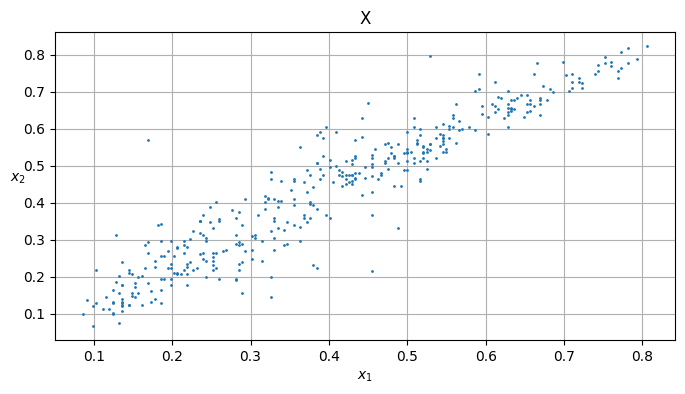

In [19]:
#Vemos la relación entre las primeras dos variables de nuestros datos sin PCA.
def plot_clusters(X, y=None):
    plt.scatter(X[:, 0], X[:, 1], c=y, s=1)
    plt.xlabel("$x_1$")
    plt.ylabel("$x_2$", rotation=0)

plt.figure(figsize=(8, 4))
plot_clusters(X)
plt.gca().set_axisbelow(True)
plt.title("X")
plt.grid()
plt.show()

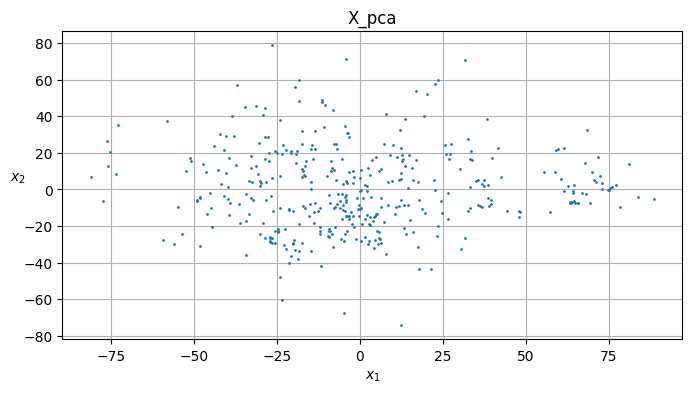

In [ ]:
#Vemos la relación entre las primeras dos variables después de usar PCA.
#Realmente los gráficos no son nada representativos para nosotros pero nos sirven para ver que PCA se ha aplicado correctamente y los datos con los que trabajaremos serán distintos.
plt.figure(figsize=(8, 4))
plot_clusters(X_pca)
plt.gca().set_axisbelow(True)
plt.title("X_pca")
plt.grid()
plt.show()

In [100]:
#Vamos a hacer 40 grupos ya que sabemos que tenemos 10 imágenes de 40 personas distintas.
#Por los tanto si creáramos un modelo perfecto con un %100 de acierto, tendría que ser un modelo con 40 clusters.
k = 40
kmeans = KMeans(n_clusters=k, random_state=42)
y_pred = kmeans.fit_predict(X_pca)

In [101]:
y_pred

array([24, 35, 24, 37,  2, 37, 24, 39, 24, 19, 21, 21, 21, 21, 21, 21, 21,
       21, 21, 21, 22, 22, 22, 18, 18,  7, 39, 39,  2,  2,  0,  0, 20,  2,
        2, 39,  2, 20,  0,  0, 20,  9, 22, 20,  3,  3, 20,  3,  3, 39,  2,
        2,  2, 14, 14, 14, 14, 14, 14, 14, 32, 32, 25, 32, 32, 25, 32, 32,
       25, 32, 23, 23, 23, 35, 23, 23, 35, 23, 37, 35, 36, 22, 36, 20, 20,
       20, 20, 20, 20, 22, 31, 22, 35, 35, 19, 19, 19, 19, 39,  2,  6,  6,
        6,  6,  6,  6,  6,  6,  6,  6, 19, 36, 36, 36, 36, 39, 36, 19, 19,
       19,  0,  0, 20, 20,  2,  0, 18, 18,  2,  2, 27, 27, 27, 27, 27, 27,
       27, 27, 27, 27,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 13, 24, 24,
        2,  2, 13, 24, 39, 24, 24,  3,  3,  7,  7,  3,  3,  3,  3,  3,  3,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2, 29, 29, 29, 23, 23, 29, 23,
       23, 23, 29,  0,  0,  0,  0, 34,  0, 34, 34, 34,  0,  8,  8,  8, 18,
       22, 22, 18, 18, 22, 18, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12,  2,
        2, 31, 20, 31, 20

In [103]:
#Las posiciones de los 40 puntos centrales. Son posiciones de 260 dimensiones. 
kmeans.cluster_centers_

array([[ 4.76071240e+00, -7.52497974e+00, -1.16970603e+01, ...,
        -2.57839930e-02,  1.75131665e-02, -3.39738734e-03],
       [ 2.93024917e+01,  1.89059158e+01,  1.27741054e+01, ...,
        -3.17146393e-01, -5.34051645e-01, -1.26516334e-01],
       [-3.38667217e+01, -5.32544582e+00,  2.95911914e+00, ...,
        -1.61178706e-02, -6.38924837e-03, -7.06932258e-02],
       ...,
       [-3.98332841e+01,  5.36781993e+01, -4.64020601e+00, ...,
        -1.87498192e-02,  3.58193952e-01, -2.11403428e-01],
       [-1.69675908e+01, -2.75875236e+01, -1.73151951e+01, ...,
        -2.45483776e-02,  2.97836815e-02, -4.31255226e-02],
       [-3.28762036e+01,  2.96253994e+01,  7.94225703e+00, ...,
        -3.10106816e-01,  5.10011636e-02, -1.91215826e-02]])

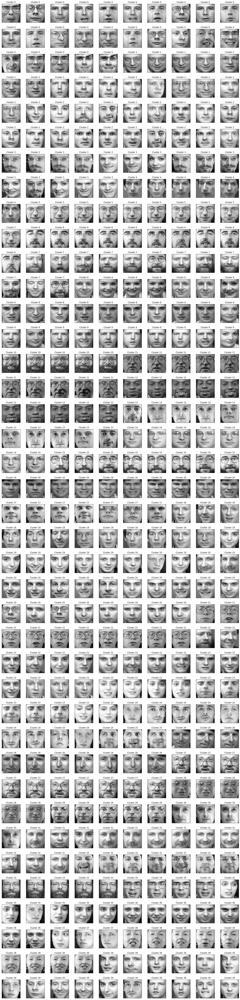

In [99]:
labels = kmeans.labels_

# Ordenar las imágenes y etiquetas según los clusters
sorted_indices = np.argsort(labels)
sorted_X = X[sorted_indices]
sorted_labels = labels[sorted_indices]

# Función para graficar imágenes agrupadas por cluster
def plot_faces(X, labels, h=64, w=64, n_row=40, n_col=10):
    plt.figure(figsize=(2. * n_col, 2.26 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(X[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.xticks(())
        plt.yticks(())
        plt.title(f"Cluster {labels[i]}")

# Visualizar las imágenes agrupadas por cluster
plot_faces(sorted_X, sorted_labels, h=64, w=64)
plt.show()

In [ ]:
#Vemos que el modelo es realmente malo, hay algunos clusters donde agrupa hasta 25 imágenes de 6 o 7 personas distintas y hay otros clusters con solo 3 imágenes.
#También podemos ver que no es un desastre ya que acierta bastante agrupando personas con gafas o barba y que son más faciles de reconocer que otras características.

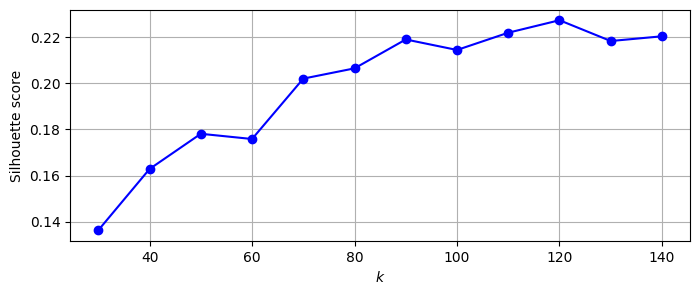

In [123]:
#Vamos a usar el coeficiente de la silueta para medir el mejor valor para k.
#Buscaremos entre el rango k=30 a k=140 con un paso de 10.
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(X_pca) for k in range(30, 150, 10)]

silhouette_scores = [silhouette_score(X_pca, model.labels_) for model in kmeans_per_k]

plt.figure(figsize=(8, 3))
plt.plot(range(30, 150, 10), silhouette_scores, "bo-")  
plt.xlabel("$k$")
plt.ylabel("Silhouette score")
plt.grid()
plt.show()

In [ ]:
#El mejor valor encontrado ha sido k=120.

In [124]:
kmeans120 = KMeans(n_clusters=120, random_state=42)
kmeans120.fit(X_pca)

KMeans(n_clusters=120, random_state=42)

In [125]:
silhouette_score(X_pca, kmeans120.labels_)

0.22721778738966006

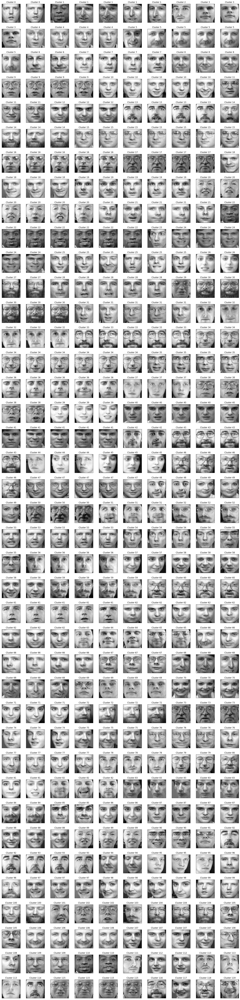

In [106]:
labels = kmeans120.labels_

# Ordenar las imágenes y etiquetas según los clusters
sorted_indices = np.argsort(labels)
sorted_X = X[sorted_indices]
sorted_labels = labels[sorted_indices]

# Función para graficar imágenes agrupadas por cluster
def plot_faces(X, labels, h=64, w=64, n_row=40, n_col=10):
    plt.figure(figsize=(2. * n_col, 2.26 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(X[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.xticks(())
        plt.yticks(())
        plt.title(f"Cluster {labels[i]}")

# Visualizar las imágenes agrupadas por cluster
plot_faces(sorted_X, sorted_labels, h=64, w=64)
plt.show()

In [ ]:
#Al crear 120 grupos no se equivoca tanto mezclando personas distintas en mismos grupos, por otro lado también tenemos grupos con solamente 1 imagen.
#En nuestra opinión esta es una mejor agrupación que el k=40 y aunque está muy lejos de ser perfecto no se equivoca demasiado.
#También hay que tener en cuenta que le estamos obligando a que haga 120 grupos por lo cual tiene ese margen para crear clusters con una imagen que le parezca muy distinto a todo lo que ha visto. 

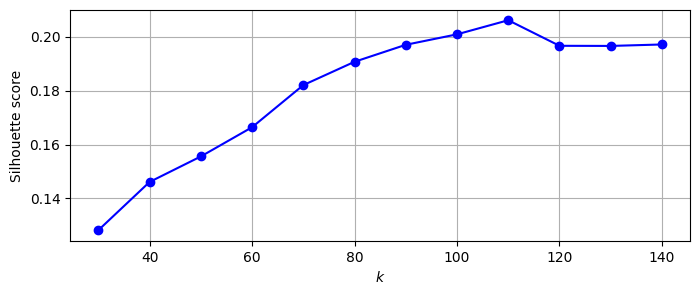

In [126]:
#Vamos a usar el coeficiente de la silueta para medir el mejor valor para k.
#Buscaremos entre el rango k=30 a k=140 con un paso de 10.
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(X) for k in range(30, 150, 10)]

silhouette_scores = [silhouette_score(X, model.labels_) for model in kmeans_per_k]

plt.figure(figsize=(8, 3))
plt.plot(range(30, 150, 10), silhouette_scores, "bo-")  
plt.xlabel("$k$")
plt.ylabel("Silhouette score")
plt.grid()
plt.show()

In [ ]:
#El mejor valor encontrado ha sido k=110.

In [127]:
kmeans110 = KMeans(n_clusters=110, random_state=42)
kmeans110.fit(X)

KMeans(n_clusters=110, random_state=42)

In [128]:
silhouette_score(X, kmeans110.labels_)

0.20611222509562357

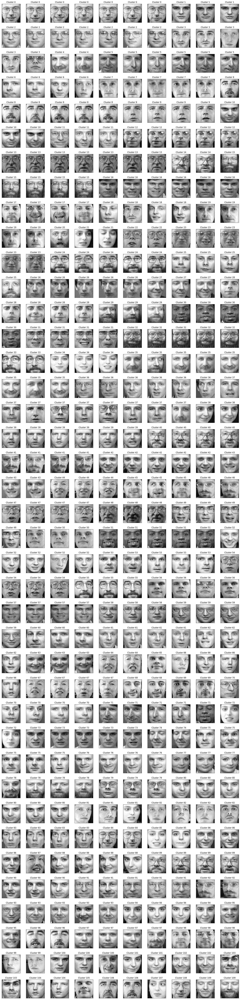

In [113]:
labels = kmeans110.labels_

# Ordenar las imágenes y etiquetas según los clusters
sorted_indices = np.argsort(labels)
sorted_X = X[sorted_indices]
sorted_labels = labels[sorted_indices]

# Función para graficar imágenes agrupadas por cluster
def plot_faces(X, labels, h=64, w=64, n_row=40, n_col=10):
    plt.figure(figsize=(2. * n_col, 2.26 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(X[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.xticks(())
        plt.yticks(())
        plt.title(f"Cluster {labels[i]}")

# Visualizar las imágenes agrupadas por cluster
plot_faces(sorted_X, sorted_labels, h=64, w=64)
plt.show()

In [ ]:
#Los resultados a simple vista son parecidos al modelo k=120 con PCA. Vuelve a crear muchos grupos (110) y pocas veces junta personas distintas en mismos grupos,
# aunque igual lo hace alguna vez más que el otro modelo. Al crear menos grupos parece que hay menos clusters con una sola imagen.

Valoración general

In [ ]:
#Tanto para los datos usando PCA como para los datos originales el tiempo de ejecución ha sido muy parecido para nosotros, por lo cual no podemos destacar ningún modelo en este aspecto.
#En cuanto a los resultados, si lo evaluamos visualmente diría que los resultados son parecidos,
# crean 110 o 120 grupos para imágenes de 40 personas y rara vez agrupan personas distintas en el mismo grupo aunque sí separan imágenes de la misma persona en distintos grupos.
#Por eso vamos a utilizar el coeficiente de la silueta para elegir el mejor modelo, ya que al tener tantas imagenes es díficil hacer una valoración global de los modelos visualmente.
# En el caso de los datos con PCA hemos conseguido un 0.227 y en el otro hemos conseguido un 0.206, así que vamos a quedarnos con los datos con PCA y k=120.

In [130]:
#Pipeline del modelo final.
modelo_final = make_pipeline(
    StandardScaler(),
    PCA(n_components=0.99),
    KMeans(n_clusters=120, random_state=42))

#Entrenamos el modelo final
modelo_final.fit(X)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=0.99)),
                ('kmeans', KMeans(n_clusters=120, random_state=42))])

In [133]:
#Guardamos el mejor modelo
joblib.dump(modelo_final, "../../../recursos/modelos/imagenes.pkl")

['../../../recursos/modelos/imagenes.pkl']